# about

evalutions of pseudobulk rna-seq samples

In [1]:
# gene quantification
ref_genome_tcga = "hg19"  # "hg19" or "hg38"
gene_units_tcga = "tpm"  # "tpm" or "counts"
# data quality
mets_only_tcga = True
gene_sparsity_ceiling_tcga = 0.5
# pseudobulk generation parameters
n_cells_per_cell_type = 10
malignant_from_one_sample = True

In [2]:
import pathlib

base = pathlib.Path("figures-8a")
figure_path = base / ";".join([f"ref_genome_tcga={ref_genome_tcga}", f"gene_units_tcga={gene_units_tcga}"])
figure_path.mkdir(parents=True, exist_ok=True)
figure_path

PosixPath('figures-8a/ref_genome_tcga=hg19;gene_units_tcga=tpm')

# imports

In [3]:
import logging

import helpers
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io

In [4]:
handler = logging.StreamHandler()
formatter = logging.Formatter("%(asctime)s - %(name)s - %(levelname)s - %(message)s")
handler.setFormatter(formatter)
logging.getLogger().addHandler(handler)

In [5]:
logging.getLogger("gcsfs").setLevel("INFO")
logging.getLogger("google.cloud.bigquery").setLevel("DEBUG")
logging.getLogger("helpers").setLevel("DEBUG")
logging.getLogger("pandas").setLevel("DEBUG")
logging.getLogger("pyarrow").setLevel("DEBUG")

In [6]:
logger = logging.getLogger(__name__)
logger.setLevel("DEBUG")

In [7]:
rng = np.random.default_rng(seed=0)

# loading data

In [8]:
%%time
if ref_genome_tcga == "hg19" and gene_units_tcga == "tpm":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg19_scaled_estimate_firebrowse()
elif ref_genome_tcga == "hg19" and gene_units_tcga == "counts":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg19_normalized_counts_dereks_file()
elif ref_genome_tcga == "hg38" and gene_units_tcga == "tpm":
    bulk_tcga_skcm = helpers.datasets.load_tcga_skcm_hg38_fpkm_bigquery()
else:
    raise ValueError

2022-04-15 20:38:07,924 - helpers.datasets - DEBUG - reading gs://liulab/firebrowse.org/SKCM.rnaseqv2__illuminahiseq_rnaseqv2__unc_edu__Level_3__RSEM_genes__data.data.txt


CPU times: user 18 s, sys: 1.86 s, total: 19.9 s
Wall time: 27.1 s


In [9]:
bulk_tcga_skcm

sample_id,TCGA-3N-A9WB-06A-11R-A38C-07,TCGA-3N-A9WC-06A-11R-A38C-07,TCGA-3N-A9WD-06A-11R-A38C-07,TCGA-BF-A1PU-01A-11R-A18S-07,TCGA-BF-A1PV-01A-11R-A18U-07,TCGA-BF-A1PX-01A-12R-A18T-07,TCGA-BF-A1PZ-01A-11R-A18S-07,TCGA-BF-A1Q0-01A-21R-A18S-07,TCGA-BF-A3DJ-01A-11R-A20F-07,TCGA-BF-A3DL-01A-11R-A20F-07,...,TCGA-XV-AB01-06A-12R-A40A-07,TCGA-YD-A89C-06A-11R-A37K-07,TCGA-YD-A9TA-06A-11R-A39D-07,TCGA-YD-A9TB-06A-12R-A40A-07,TCGA-YG-AA3N-01A-11R-A38C-07,TCGA-YG-AA3O-06A-11R-A38C-07,TCGA-YG-AA3P-06A-11R-A38C-07,TCGA-Z2-A8RT-06A-11R-A37K-07,TCGA-Z2-AA3S-06A-11R-A39D-07,TCGA-Z2-AA3V-06A-11R-A39D-07
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,1.557260e-05,9.770979e-06,9.867653e-06,8.214494e-06,1.319182e-05,0.000011,2.007678e-05,1.600174e-05,1.162966e-05,1.341190e-05,...,1.225520e-05,7.024648e-06,4.711307e-06,1.420643e-05,8.895070e-06,9.687238e-06,1.050934e-06,1.546427e-05,1.734078e-05,2.151290e-05
A1CF,0.000000e+00,0.000000e+00,1.618365e-08,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,6.341529e-08,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.491286e-08,0.000000e+00,0.000000e+00
A2BP1,0.000000e+00,0.000000e+00,7.355062e-08,2.535232e-08,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,7.149177e-09,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.630355e-09,1.622909e-08,1.028863e-06,0.000000e+00,6.274466e-09,8.150594e-09
A2LD1,1.215530e-05,1.007630e-05,2.913834e-06,8.091553e-06,4.023093e-06,0.000006,4.097277e-06,3.721209e-06,5.424464e-06,3.828798e-06,...,1.582717e-06,4.745975e-06,2.434800e-06,9.501916e-06,3.484441e-06,4.954726e-06,1.895828e-06,1.980472e-06,9.025434e-06,1.570295e-06
A2M,7.898068e-05,4.824242e-03,4.009156e-04,1.988917e-04,6.568233e-05,0.000866,1.008798e-04,2.122453e-04,1.082367e-02,1.677088e-04,...,3.109038e-04,5.432744e-04,4.078196e-04,8.717802e-04,2.251480e-04,9.524274e-04,1.826842e-04,6.155309e-04,1.256629e-04,7.927380e-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYX,4.357639e-05,1.539616e-04,7.764624e-05,2.026416e-04,2.610161e-04,0.000148,1.239069e-04,4.407042e-04,1.274164e-04,2.085949e-04,...,2.773654e-04,1.748523e-04,1.755739e-04,1.399126e-04,3.213358e-04,1.277219e-04,6.092688e-05,1.117664e-04,9.318113e-05,2.970830e-04
ZZEF1,3.959755e-06,7.324083e-06,4.961625e-06,1.249919e-05,1.092226e-05,0.000008,1.195551e-05,9.538079e-06,1.064299e-05,7.760680e-06,...,6.364188e-06,5.525628e-06,1.240367e-05,9.237133e-06,1.359631e-05,2.181535e-05,8.731424e-06,1.592902e-05,1.382386e-05,6.305414e-06
ZZZ3,1.620152e-05,2.734027e-05,1.091091e-05,6.605331e-06,4.731625e-05,0.000009,1.608780e-05,2.038022e-05,2.351191e-05,5.271489e-06,...,3.188710e-06,1.454040e-05,2.546843e-05,1.947630e-05,2.197529e-05,2.183025e-05,1.750435e-05,1.079364e-05,3.497588e-05,1.693527e-06


In [10]:
%%time
fractions_tcga_skcm = helpers.datasets.load_tcga_skcm_fractions_from_csx()

2022-04-15 20:38:35,136 - helpers.datasets - DEBUG - loading TCGA SKCM fractions estimated by CIBERSORTx


CPU times: user 18.3 ms, sys: 252 µs, total: 18.5 ms
Wall time: 67.8 ms


In [11]:
%%time
sc_jerby_arnon, sc_metadata_jerby_arnon = helpers.datasets.load_jerby_arnon_hg19_tpm()

2022-04-15 20:38:35,225 - helpers.datasets - DEBUG - loading Jerby-Arnon scRNA-seq data
2022-04-15 20:39:20,042 - helpers.datasets - DEBUG - loading Jerby-Arnon metadata


CPU times: user 54.5 s, sys: 8.62 s, total: 1min 3s
Wall time: 44.9 s


In [12]:
# determine gene exclusions

exclusions_genes = pd.DataFrame(index=bulk_tcga_skcm.index.union(sc_jerby_arnon.index))

## sparsity in tcga
genes_sparse_tcga_skcm = bulk_tcga_skcm[(bulk_tcga_skcm == 0).mean(axis=1) > gene_sparsity_ceiling_tcga].index
exclusions_genes["sparse_in_tcga_skcm"] = exclusions_genes.index.map(lambda g: g in genes_sparse_tcga_skcm)

## genes not in both cohorts
genes_in_both = bulk_tcga_skcm.index.intersection(sc_jerby_arnon.index)
exclusions_genes["not_in_both_cohorts"] = exclusions_genes.index.map(lambda gene_name: gene_name not in genes_in_both)

good_genes = exclusions_genes.loc[~exclusions_genes.any(axis=1)].index

https://console.cloud.google.com/bigquery?authuser=1&project=keen-dispatch-316219

In [13]:
# determine tcga sample exclusions

exclusions_tcga_samples = pd.DataFrame(index=bulk_tcga_skcm.columns)

## limit to metastases

if mets_only_tcga:
    query_text = """
        SELECT aliquot_barcode
        FROM `keen-dispatch-316219.gdc_tcga_skcm_subset.aliquot2caseIDmap_current`
        WHERE sample_type_name = 'Metastatic'
    """
    metastatic_aliquot_barcodes = pd.read_gbq(query_text)["aliquot_barcode"].values
    exclusions_tcga_samples["is_not_metastatic"] = exclusions_tcga_samples.index.map(
        lambda sample: sample not in metastatic_aliquot_barcodes
    )

good_tcga_samples = exclusions_tcga_samples.loc[~exclusions_tcga_samples.any(axis=1)].index

In [14]:
# apply exclusions

print("before exclusions:", [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)])
sc_jerby_arnon = sc_jerby_arnon.loc[good_genes]
bulk_tcga_skcm = bulk_tcga_skcm.loc[good_genes][good_tcga_samples]
fractions_tcga_skcm = fractions_tcga_skcm.loc[good_tcga_samples]
print("after exclusions:", [df.shape for df in (sc_jerby_arnon, bulk_tcga_skcm, fractions_tcga_skcm)])

before exclusions: [(23686, 7186), (20501, 473), (473, 9)]
after exclusions: [(16063, 7186), (16063, 368), (368, 9)]


In [15]:
# convert to units per million

bulk_tcga_skcm *= 1_000_000 / bulk_tcga_skcm.sum()
sc_jerby_arnon *= 1_000_000 / sc_jerby_arnon.sum()

In [16]:
# compute pseudobulks and their cell type GEPs

bulk_pseudo, bulk_pseudo_cell_type_geps = helpers.creating_mixtures.make_mixtures(
    sc_jerby_arnon,
    sc_metadata_jerby_arnon,
    fractions_tcga_skcm.rename(index=lambda sample: f"pseudo_like_{sample}"),
    n_cells_per_gep=n_cells_per_cell_type,
    normalization_factor=1_000_000,
    malignant_from_one_sample=malignant_from_one_sample,
    rng=rng,
)

2022-04-15 20:39:22,711 - helpers.creating_mixtures - DEBUG - using np.random.Generator with BitGenerator state {'state': 35399562948360463058890781895381311971, 'inc': 87136372517582989555478159403783844777}
2022-04-15 20:39:22,715 - helpers.creating_mixtures - DEBUG - randomly chose Mel79 for malignant cells
2022-04-15 20:39:22,783 - helpers.creating_mixtures - DEBUG - randomly chose Mel82 for malignant cells
2022-04-15 20:39:22,863 - helpers.creating_mixtures - DEBUG - randomly chose Mel129pa for malignant cells
2022-04-15 20:39:22,988 - helpers.creating_mixtures - DEBUG - randomly chose Mel78 for malignant cells
2022-04-15 20:39:23,060 - helpers.creating_mixtures - DEBUG - randomly chose Mel112 for malignant cells
2022-04-15 20:39:23,131 - helpers.creating_mixtures - DEBUG - randomly chose Mel89 for malignant cells
2022-04-15 20:39:23,202 - helpers.creating_mixtures - DEBUG - randomly chose Mel102 for malignant cells
2022-04-15 20:39:23,274 - helpers.creating_mixtures - DEBUG - ran

# figures

## mean dists

In [17]:
bulk_all = pd.concat({"tcga skcm": bulk_tcga_skcm, "pseudobulk": bulk_pseudo}, axis=1)
dfg = bulk_all.stack().groupby("gene_symbol")
log_means = np.log10(dfg.aggregate("mean") + 1e-2)
log_stddevs = np.log10(dfg.aggregate("std") + 1e-2)

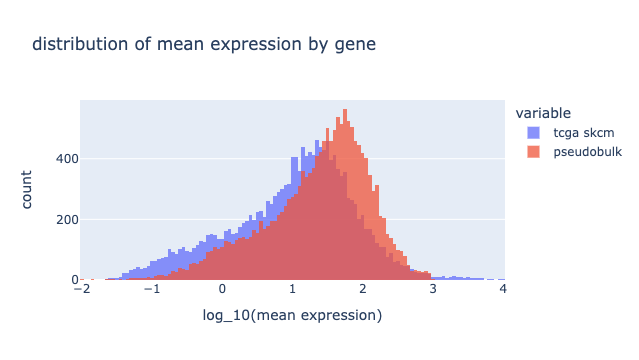

In [18]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of mean expression by gene"
x_axis_title = "log_10(mean expression)"
fig = px.histogram(log_means, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [19]:
fig.write_image(figure_path / "mean_dist.png", width=800, height=500, scale=2)

### looking into very high expressed TCGA SKCM genes...

In [20]:
log_means.nlargest(10, columns=["tcga skcm"])

,tcga skcm,pseudobulk
gene_symbol,,
GAPDH,4.012246,3.009095
RPLP1,3.989264,2.997479
FTL,3.957734,2.970934
RPS18,3.927969,2.990632
B2M,3.841852,2.906620
RPL37A,3.830827,2.916458
TPT1,3.823056,2.931053
ACTB,3.816013,2.958090
CD74,3.739689,2.432555


## stddev dists

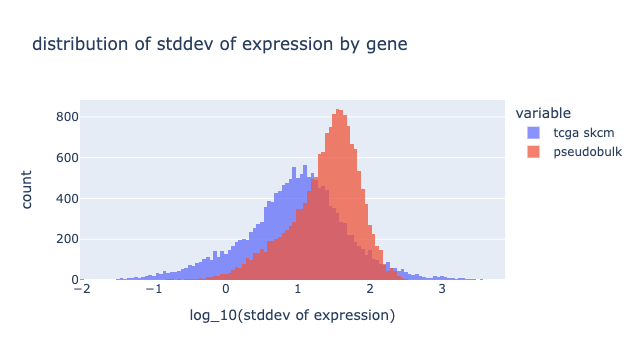

In [21]:
# df = pd.DataFrame({"tcga skcm": aggregate(bulk_tcga_skcm), "pseudobulks": aggregate(bulk_pseudo)})
title = "distribution of stddev of expression by gene"
x_axis_title = "log_10(stddev of expression)"
fig = px.histogram(log_stddevs, title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.75)
fig.update_xaxes(title=x_axis_title)

In [22]:
fig.write_image(figure_path / "stddev_dist.png", width=800, height=500, scale=2)

## mean jointdist scatter

/opt/conda/envs/deconv/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning:

divide by zero encountered in log10

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1652: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1687: RuntimeWarning:

invalid value encountered in subtract



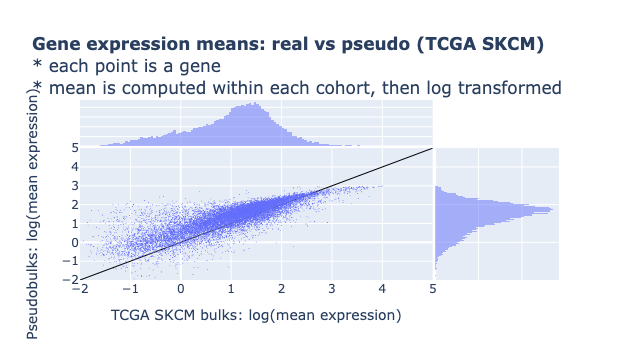

In [23]:
title = (
    "<b>Gene expression means: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* mean is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 5]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.mean(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.mean(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(mean expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
# fig.show(height=800)

In [24]:
fig.write_image(figure_path / "mean_jointdist_scatter.png", width=800, height=700, scale=2)

## stddev jointdist scatter

/opt/conda/envs/deconv/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning:

divide by zero encountered in log10

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1652: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/envs/deconv/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1687: RuntimeWarning:

invalid value encountered in subtract



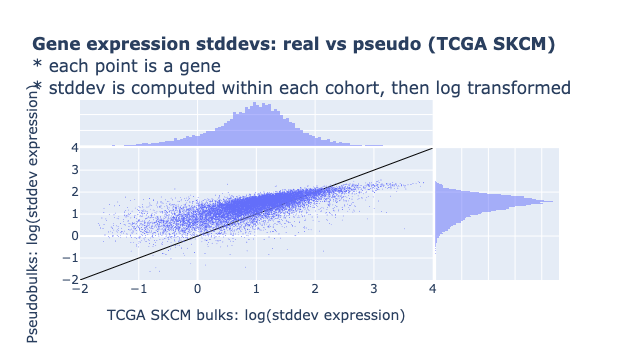

In [25]:
title = (
    "<b>Gene expression stddevs: real vs pseudo (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* stddev is computed within each cohort, then log transformed"
)
label_real, label_pseudo = "TCGA SKCM bulks", "pseudobulks"
axis_range = [-2, 4]

df = pd.DataFrame(
    {
        label_real: np.log10(bulk_tcga_skcm.std(axis=1)),
        f"{label_real} sparsity": (bulk_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(bulk_pseudo.std(axis=1)),
        f"{label_pseudo} sparsity": (bulk_pseudo == 0).mean(axis=1),
    },
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
    trendline="ols",
)
fig.add_trace(
    go.Scatter(
        x=axis_range,
        y=axis_range,
        marker=dict(color="black"),
        line=dict(width=1),
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM bulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.update_yaxes(
    title="Pseudobulks: log(stddev expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=axis_range,
)
fig.show(height=800)

In [26]:
fig.write_image(figure_path / "stddev_jointdist_scatter.png", width=800, height=700, scale=2)

## PCA

In [27]:
all_bulks = pd.concat(
    {"tcga skcm": bulk_tcga_skcm, "pseudobulks": bulk_pseudo}, axis=1, names=["sample_origin", helpers.columns.SAMPLE_ID]
).T

In [28]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(all_bulks)
all_bulks.values[:] = scaler.transform(all_bulks)

all_bulks.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A2M,A2ML1,A4GALT,A4GNT
mean,-9.267949e-16,8.109455e-16,0.00000,-7.723291e-17,9.654113e-18
std,1.000680e+00,1.000680e+00,1.00068,1.000680e+00,1.000680e+00


In [29]:
from sklearn.decomposition import PCA

n_components = 10

pca = PCA(n_components=n_components)
pca.fit(all_bulks)
pca_gene_eigenvectors = (
    pd.DataFrame(pca.components_, columns=all_bulks.columns, index=["PC " + str(i + 1) for i in range(n_components)])
    .rename_axis(index="PCs")
    .T
)
pca_plot_axis_labels = {str(i): f"PC {i+1}<br>({var:.1f}%)" for i, var in enumerate(pca.explained_variance_ratio_ * 100)}

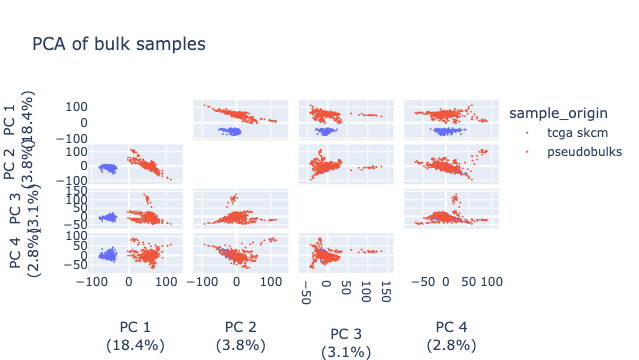

In [30]:
pca_coefficients_all_bulks = pd.DataFrame(pca.transform(all_bulks), index=all_bulks.index).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_4_samples.png", width=800, height=700, scale=2)

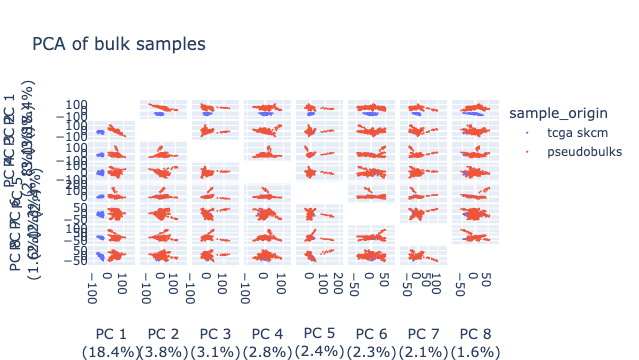

In [31]:
fig = px.scatter_matrix(
    pca_coefficients_all_bulks,
    labels=pca_plot_axis_labels,
    dimensions=range(8),
    color="sample_origin",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of bulk samples",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_8_samples.png", width=800, height=700, scale=2)

### applied to pseudobulk cell type GEPs

In [32]:
pseudo_cell_type_geps = pd.concat(
    bulk_pseudo_cell_type_geps, axis=1, names=[helpers.columns.SAMPLE_ID, helpers.columns.CELL_TYPE]
).T
pseudo_cell_type_geps.values[:] = scaler.transform(pseudo_cell_type_geps)
pseudo_cell_type_geps.iloc[:, :5].agg(["mean", "std"])

gene_symbol,A1BG,A2M,A2ML1,A4GALT,A4GNT
mean,-0.229346,-0.438804,1.325902,0.933241,0.289086
std,1.028955,0.138283,1.466150,3.449868,2.568036


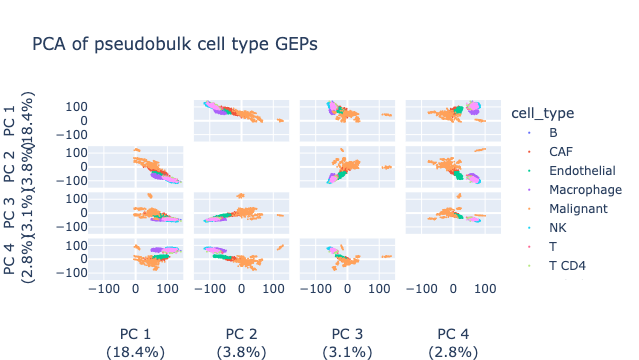

In [33]:
pca_coefficients_pseudo_cell_type_geps = pd.DataFrame(
    pca.transform(pseudo_cell_type_geps), index=pseudo_cell_type_geps.index
).reset_index()

fig = px.scatter_matrix(
    pca_coefficients_pseudo_cell_type_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color=helpers.columns.CELL_TYPE,
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.show(height=800)
fig.write_image(figure_path / "pca_4_pseudo_cell_type_geps.png", width=800, height=700, scale=2)

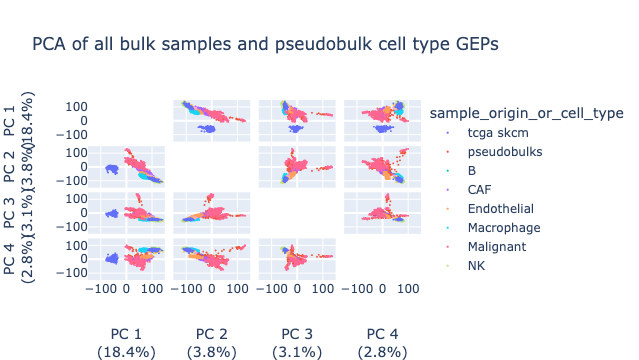

In [34]:
pca_coefficients_bulks_and_geps = pd.concat([pca_coefficients_all_bulks, pca_coefficients_pseudo_cell_type_geps])
pca_coefficients_bulks_and_geps["sample_origin_or_cell_type"] = pca_coefficients_bulks_and_geps["sample_origin"].fillna(
    pca_coefficients_bulks_and_geps["cell_type"]
)

fig = px.scatter_matrix(
    pca_coefficients_bulks_and_geps,
    labels=pca_plot_axis_labels,
    dimensions=range(4),
    color="sample_origin_or_cell_type",
    hover_name=helpers.columns.SAMPLE_ID,
    title="PCA of all bulk samples and pseudobulk cell type GEPs",
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.update_layout({f"xaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.update_layout({f"yaxis{i}": dict(range=[-150, 150]) for i in range(1, 50)})
fig.write_image(figure_path / "pca_4_bulks_and_geps.png", width=800, height=700, scale=2)
fig.show(height=1000, width=800)

### first PC

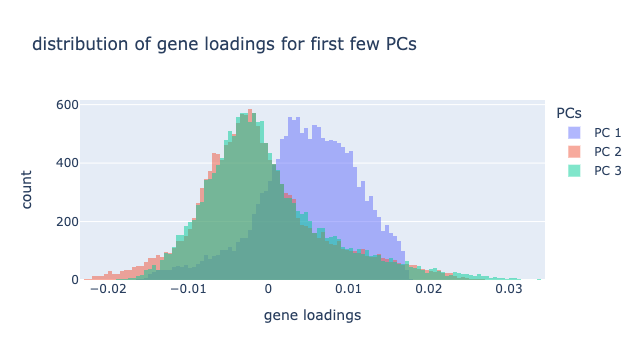

In [35]:
title = "distribution of gene loadings for first few PCs"
fig = px.histogram(pca_gene_eigenvectors.iloc[:, :3], title=title)
fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.5)
fig.update_xaxes(title="gene loadings")

In [36]:
gene_features = pca_gene_eigenvectors.iloc[:, :3]
gene_features["sparse_rate_bulk_tcga_skcm"] = (bulk_tcga_skcm == 0).mean(axis=1)
gene_features["sparse_rate_sc_jerby_arnon"] = (sc_jerby_arnon == 0).mean(axis=1)
gene_features["mean_bulk_tcga_skcm"] = bulk_tcga_skcm.mean(axis=1)
gene_features["stddev_bulk_tcga_skcm"] = bulk_tcga_skcm.std(axis=1)
gene_features["mean_sc_jerby_arnon"] = sc_jerby_arnon.mean(axis=1)
gene_features["stddev_sc_jerby_arnon"] = sc_jerby_arnon.std(axis=1)

In [37]:
gene_features.corr(
    # method="spearman"
)

PCs,PC 1,PC 2,PC 3,sparse_rate_bulk_tcga_skcm,sparse_rate_sc_jerby_arnon,mean_bulk_tcga_skcm,stddev_bulk_tcga_skcm,mean_sc_jerby_arnon,stddev_sc_jerby_arnon
PCs,,,,,,,,,
PC 1,1.000000,0.108293,0.018815,-0.072193,-0.446821,-0.290392,-0.278535,0.042431,0.162939
PC 2,0.108293,1.000000,-0.003238,-0.031817,-0.046193,0.029324,-0.002459,0.134316,0.191173
PC 3,0.018815,-0.003238,1.000000,-0.084431,-0.016799,-0.006498,0.000577,-0.030588,-0.001651
sparse_rate_bulk_tcga_skcm,-0.072193,-0.031817,-0.084431,1.000000,0.244568,-0.074164,-0.054330,-0.201439,-0.360403
sparse_rate_sc_jerby_arnon,-0.446821,-0.046193,-0.016799,0.244568,1.000000,-0.266854,-0.189164,-0.691016,-0.614836
mean_bulk_tcga_skcm,-0.290392,0.029324,-0.006498,-0.074164,-0.266854,1.000000,0.885758,0.642255,0.394476
stddev_bulk_tcga_skcm,-0.278535,-0.002459,0.000577,-0.054330,-0.189164,0.885758,1.000000,0.500689,0.329137
mean_sc_jerby_arnon,0.042431,0.134316,-0.030588,-0.201439,-0.691016,0.642255,0.500689,1.000000,0.816679
stddev_sc_jerby_arnon,0.162939,0.191173,-0.001651,-0.360403,-0.614836,0.394476,0.329137,0.816679,1.000000


In [ ]:
fig = px.scatter_matrix(gene_features, hover_name=gene_features.index)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))
fig.show(height=800)
fig.write_image(figure_path / "gene_features_scatter_matrix.png", width=800, height=700, scale=2)

In [ ]:
gene_features.sort_values(by="PC 1", ascending=False)

In [ ]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_sc_jerby_arnon",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

In [ ]:
fig = px.scatter(
    gene_features,
    x="PC 1",
    y="sparse_rate_bulk_tcga_skcm",
    trendline="ols",
)
fig.update_traces(marker=dict(size=1))

In [ ]:
pca_gene_eigenvectors["PC 1"].nlargest(10)

In [ ]:
px.histogram(bulk_tcga_skcm.loc["ODF2L"])

In [ ]:
px.histogram(sc_jerby_arnon.loc["ODF2L"])